In [53]:
## Use Python 3.11.x
# conda install -c conda-forge cudatoolkit cudnn

In [54]:
# from tensorflow.python.platform import build_info as tf_build_info

# print(tf_build_info.cudnn_version_number)

In [55]:
import os
import pandas as pd
import numpy as np
import math
import datetime as dt
import matplotlib.pyplot as plt

# For Evalution we will use these library

from sklearn.metrics import mean_squared_error, mean_absolute_error, explained_variance_score, r2_score 
from sklearn.metrics import mean_poisson_deviance, mean_gamma_deviance, accuracy_score
from sklearn.preprocessing import MinMaxScaler

# For model building we will use these library

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.layers import LSTM


# For PLotting we will use these library

import matplotlib.pyplot as plt
from itertools import cycle
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots

In [56]:
import pandas as pd
columns_to_skip = ['tick_volume','spread','real_volume','SMA_10','RSI_14', 'EMA_20','VWAP_14','OBV','ATR_14']
file_path = 'data_with_indicators_minutes.csv'
df = pd.read_csv(file_path, usecols=lambda column: column not in columns_to_skip)

In [57]:
df['time'] = pd.to_datetime(df['time'],unit='s')

In [58]:
print('Total number of days present in the dataset: ',df.shape[0])
print('Total number of fields present in the dataset: ',df.shape[1])

Total number of days present in the dataset:  99817
Total number of fields present in the dataset:  5


In [59]:
df.shape

(99817, 5)

In [60]:
df.head()

,time,open,high,low,close
0,2023-05-15 01:15:00,26920.88,26921.99,26894.54,26914.56
1,2023-05-15 01:20:00,26914.56,26949.22,26914.18,26931.47
2,2023-05-15 01:25:00,26931.47,26939.72,26900.97,26904.47
3,2023-05-15 01:30:00,26907.97,26942.22,26903.97,26936.01
4,2023-05-15 01:35:00,26937.01,26937.51,26876.39,26891.38


In [61]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99817 entries, 0 to 99816
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   time    99817 non-null  datetime64[ns]
 1   open    99817 non-null  float64       
 2   high    99817 non-null  float64       
 3   low     99817 non-null  float64       
 4   close   99817 non-null  float64       
dtypes: datetime64[ns](1), float64(4)
memory usage: 3.8 MB


In [62]:
df.describe()

,time,open,high,low,close
count,99817,99817.000000,99817.000000,99817.000000,99817.000000
mean,2023-11-06 10:13:19.721490432,39798.232711,39835.693689,39758.878711,39798.943933
min,2023-05-15 01:15:00,24211.480000,24866.740000,24178.890000,24827.590000
25%,2023-08-10 17:35:00,27576.200000,27594.350000,27556.280000,27576.960000
50%,2023-11-06 08:55:00,35083.350000,35104.770000,35059.740000,35085.100000
75%,2024-02-02 01:05:00,44324.640000,44376.870000,44267.730000,44329.490000
max,2024-04-29 23:55:00,73691.490000,73843.750000,73618.880000,73691.490000
std,NaN,14364.809387,14389.347315,14338.774480,14364.888345


In [63]:
print('Null Values:',df.isnull().values.sum())

Null Values: 0


In [64]:
print('NA values:',df.isnull().values.any())

NA values: False


In [65]:
df.sort_values(by='time',ascending=True, inplace=True)


print('Starting Date',df.time.min())
print('Ending Date',df.time.max())

Starting Date 2023-05-15 01:15:00
Ending Date 2024-04-29 23:55:00


In [66]:
df[df.duplicated(['time'], keep=False)]

,time,open,high,low,close


In [67]:
names = cycle(['Stock Open Price','Stock Close Price','Stock High Price','Stock Low Price'])

fig = px.line(df, x=df.time, y=[df['open'], df['close'], 
                                          df['high'], df['low']],
             labels={'Date': 'Date','value':'Stock value'})
fig.update_layout(title_text='Stock analysis chart', font_size=15, font_color='black',legend_title_text='Stock Parameters')
fig.for_each_trace(lambda t:  t.update(name = next(names)))
fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)

fig.show()

In [68]:
closeDF = df['close'].copy()

In [69]:
closeDF.head()

0    26914.56
1    26931.47
2    26904.47
3    26936.01
4    26891.38
Name: close, dtype: float64

In [70]:
scaler=MinMaxScaler(feature_range=(0,1))
closeDF=scaler.fit_transform(np.array(closeDF).reshape(-1,1))
print(closeDF.shape)

(99817, 1)


In [98]:
closeDF

array([[0.04270985],
       [0.04305592],
       [0.04250336],
       ...,
       [0.77994736],
       [0.7795043 ],
       [0.77982969]])

In [71]:
training_size = int(len(closeDF)*0.90)
test_size = len(closeDF)-training_size
train_data, test_data = closeDF[0:training_size,:], closeDF[training_size:len(closeDF),:1]
print("train_data: ", train_data.shape)
print("test_data: ", test_data.shape)

train_data:  (89835, 1)
test_data:  (9982, 1)


## ARIMA Model

In [72]:
# ARIMA model
from statsmodels.tsa.arima.model import ARIMA
arima_model_init = ARIMA(df['close'], order=(1, 1, 1))
arima_model_init_fit = arima_model_init.fit()
arima_init_predictions = arima_model_init_fit.predict(start=len(train_data), end=len(train_data) + len(test_data) - 1)

In [73]:
arima_init_predictions

89835    70668.133496
89836    70447.272965
89837    70125.318173
89838    69997.101792
89839    69865.690544
             ...     
99812    63004.427321
99813    62938.910276
99814    62986.775765
99815    62939.874025
99816    62918.193793
Name: predicted_mean, Length: 9982, dtype: float64

In [74]:
arima_init_rmse = np.sqrt(mean_squared_error(df.close[training_size:], arima_init_predictions))
print(f"ARIMA RMSE: {arima_init_rmse}")

ARIMA RMSE: 120.13751381957742


### Different Order values
<br> Order     RMSE
<br> 0,1,0   120.0859
<br> 0,1,1   120.1157
<br> 0,1,2   120.1286
<br> 0,2,0   170.021
<br> 0,2,1   120.1106
<br> 0,2,2   120.1229
<br> 1,0,0   120.0851
<br> 1,0,1   120.1151
<br> 1,0,2   120.1280
<br> 1,1,0   120.1134
<br> 1,1,1   120.1375
<br> 1,1,2   120.1084
<br> 1,2,0   147.4427
<br> 1,2,1   120.1235
<br> 1,2,2   120.0912
<br> 2,0,0   120.1127
<br> 2,0,1   120.0846
<br> 2,0,2   120.1078
<br> 2,1,0   120.1267
<br> 2,1,1   120.1054
<br> 2,1,2   120.0904
<br> 2,2,0   137.7564
<br> 2,2,1   120.1314
<br> 2,2,2   120.1198

In [75]:
# ARIMA model
from statsmodels.tsa.arima.model import ARIMA
arima_model = ARIMA(df['close'], order=(2,0,1))
arima_model_fit = arima_model.fit()
arima_predictions = arima_model_fit.predict(start=len(train_data), end=len(train_data) + len(test_data) - 1)
arima_rmse = np.sqrt(mean_squared_error(df.close[training_size:], arima_predictions))
print(f"ARIMA RMSE: {arima_rmse}")

c:\Users\engrm\.conda\envs\bitcoinenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.



ARIMA RMSE: 120.08464956908252


In [137]:
import pickle

# save the ARIMA model as a pickle file
model_pkl_file = "arima_model.pkl"  

with open(model_pkl_file, 'wb') as file:  
    pickle.dump(arima_model_fit, file)

In [153]:
from datetime import datetime, timedelta

def getForecastIndex(forecastTime):
    try:
        forecastTime = forecastTime.strftime("%Y-%m-%d %H:%M:%S")
    except:
        pass
    forecastTime = datetime.strptime(forecastTime, "%Y-%m-%d %H:%M:%S")
    start_min = (forecastTime.minute // 5) * 5
    forecastTime = forecastTime.replace(minute=start_min, second=00)
    forecastTime = forecastTime  + timedelta(minutes=5)
    try:
        maxDate = df.time.max()
        print("Got Max Time from DF")
    except:
        maxDate = '2024-04-29 23:55:00'
        maxDate = datetime.strptime(maxDate, "%Y-%m-%d %H:%M:%S") # get max time df.time.max()
    forecastDay5min = (forecastTime - maxDate).days * 24 * 12     # 5 mins count in days delta
    forecastSec5min =  (forecastTime - maxDate).seconds / 60 / 5
    forecastIndex = int(forecastDay5min + forecastSec5min)
    print('max time', maxDate)
    print('forecast time', forecastTime)
    print('forecast Index', forecastIndex)
    return forecastIndex, forecastTime

In [154]:
forecastIndex, forecastTime = getForecastIndex('2024-05-02 04:55:00')
# forecastIndex, forecastTime = getForecastIndex(datetime.now())

Got Max Time from DF
max time 2024-04-29 23:55:00
forecast time 2024-05-02 05:00:00
forecast Index 637


In [155]:
# model is overfit check last few values 
arimaInitForecast = arima_model_init_fit.forecast(forecastIndex)
arimaInitForecast = arimaInitForecast.reset_index()
arimaInitForecast

,index,predicted_mean
0,99817,62933.110027
1,99818,62933.110037
2,99819,62933.110042
3,99820,62933.110043
4,99821,62933.110044
...,...,...
632,100449,62933.110044
633,100450,62933.110044
634,100451,62933.110044
635,100452,62933.110044


In [156]:
arimaForecast = arima_model_fit.forecast(forecastIndex)
arimaForecast = arimaForecast.reset_index()
arimaForecast

,index,predicted_mean
0,99817,62932.456414
1,99818,62932.137062
2,99819,62931.486660
3,99820,62931.164194
4,99821,62930.516917
...,...,...
632,100449,62627.620949
633,100450,62627.142089
634,100451,62626.662428
635,100452,62626.183580


In [157]:
arimaForecastValue = arimaForecast['predicted_mean'][len(arimaForecast)-1]
print('forecast Value for', forecastTime, 'is', arimaForecastValue)

forecast Value for 2024-05-02 05:00:00 is 62625.70394621529


## SARIMA model

In [80]:

from statsmodels.tsa.statespace.sarimax import SARIMAX
sarimax_model = SARIMAX(df['close'], order=(2,0,1), seasonal_order=(0, 1, 1, 12))
sarimax_model_fit = sarimax_model.fit()
sarimax_predictions = sarimax_model_fit.predict(start=len(train_data), end=len(train_data) + len(test_data) - 1)
sarimax_rmse = np.sqrt(mean_squared_error(df.close[training_size:], sarimax_predictions))
sarimax_rmse

120.08993378710497

In [138]:
# save the SARIMAX model as a pickle file
sarimax_model_pkl_file = "sarimax_model.pkl"  

with open(sarimax_model_pkl_file, 'wb') as file:  
    pickle.dump(sarimax_model_fit, file)

In [158]:
sarimaxForecast = sarimax_model_fit.forecast(forecastIndex)
sarimaxForecast = sarimaxForecast.reset_index()
sarimaxForecast

,index,predicted_mean
0,99817,62933.145858
1,99818,62935.335385
2,99819,62935.461365
3,99820,62936.858182
4,99821,62938.014046
...,...,...
632,100449,62991.910404
633,100450,62991.834975
634,100451,62992.144386
635,100452,62991.055337


In [159]:
sarimaxForecastValue = sarimaxForecast['predicted_mean'][len(sarimaxForecast)-1]
print('forecast Value for', forecastTime, 'is', sarimaxForecastValue)

forecast Value for 2024-05-02 05:00:00 is 62991.30482264146


## LSTM

In [93]:
def create_lstm_model():
    model = Sequential()
    model.add(LSTM(128, input_shape=(1, 1), activation='relu'))
    model.add(Dense(1))
    model.compile(loss='mean_squared_error', optimizer='adam')
    return model

lstm_model = create_lstm_model()
lstm_history = lstm_model.fit(np.expand_dims(train_data, axis=-1),
                              np.expand_dims(train_data, axis=-1),
                              epochs=10, batch_size=1, verbose=1)
lstm_predictions = lstm_model.predict(np.expand_dims(test_data, axis=-1))


c:\Users\engrm\.conda\envs\bitcoinenv\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/10
89835/89835 ━━━━━━━━━━━━━━━━━━━━ 97s 1ms/step - loss: 0.0013
Epoch 2/10
89835/89835 ━━━━━━━━━━━━━━━━━━━━ 131s 1ms/step - loss: 3.8246e-06
Epoch 3/10
89835/89835 ━━━━━━━━━━━━━━━━━━━━ 111s 1ms/step - loss: 3.8438e-06
Epoch 4/10
89835/89835 ━━━━━━━━━━━━━━━━━━━━ 101s 1ms/step - loss: 3.6748e-06
Epoch 5/10
89835/89835 ━━━━━━━━━━━━━━━━━━━━ 142s 2ms/step - loss: 2.8499e-06
Epoch 6/10
89835/89835 ━━━━━━━━━━━━━━━━━━━━ 88s 976us/step - loss: 2.9276e-06
Epoch 7/10
89835/89835 ━━━━━━━━━━━━━━━━━━━━ 58s 648us/step - loss: 2.7367e-06
Epoch 8/10
89835/89835 ━━━━━━━━━━━━━━━━━━━━ 61s 681us/step - loss: 2.2573e-06
Epoch 9/10
89835/89835 ━━━━━━━━━━━━━━━━━━━━ 136s 2ms/step - loss: 1.8546e-06
Epoch 10/10
89835/89835 ━━━━━━━━━━━━━━━━━━━━ 58s 648us/step - loss: 1.9903e-06
312/312 ━━━━━━━━━━━━━━━━━━━━ 0s 767us/step


In [147]:
lstm_rmse = np.sqrt(mean_squared_error(df.close[training_size:], lstm_predictions))
print(f"LSTM RMSE: {lstm_rmse}")

LSTM RMSE: 66898.0390599203


In [95]:
lstm_model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                     │ (None, 128)            │        66,560 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1)              │           129 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 200,069 (781.52 KB)

 Trainable params: 66,689 (260.50 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 133,380 (521.02 KB)

In [134]:
t1 = np.expand_dims(test_data[1], axis=-1).shape
t1

(1, 1)

In [136]:
test_data[1]

array([0.92677437])

In [135]:
# lstm_model.predict([[0.04270985]])
lstm_model.predict([np.expand_dims(test_data[1], axis=-1)])

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


array([[0.92828596]], dtype=float32)

# Gradient Boosting Regressor model

In [141]:
from sklearn.ensemble import GradientBoostingRegressor

gbr_model = GradientBoostingRegressor()
gbr_model.fit(np.arange(len(df)).reshape(-1, 1), df['close'])
gbr_predictions = gbr_model.predict(np.arange(len(train_data), len(train_data) + len(test_data)).reshape(-1, 1))

In [142]:
gbr_rmse = np.sqrt(mean_squared_error(df.close[training_size:], gbr_predictions))
print(f"Gradient Boosting Regressor RMSE: {gbr_rmse}")

Gradient Boosting Regressor RMSE: 704.1105536759754


In [144]:
# Print the RMSE values
print(f"ARIMA RMSE: {arima_rmse}")
print(f"SARIMA RMSE: {sarimax_rmse}")
print(f"LSTM RMSE: {lstm_rmse}")
print(f"Gradient Boosting Regressor RMSE: {gbr_rmse}")

ARIMA RMSE: 120.08464956908252
SARIMA RMSE: 120.08993378710497
LSTM RMSE: 66898.0390599203
Gradient Boosting Regressor RMSE: 704.1105536759754


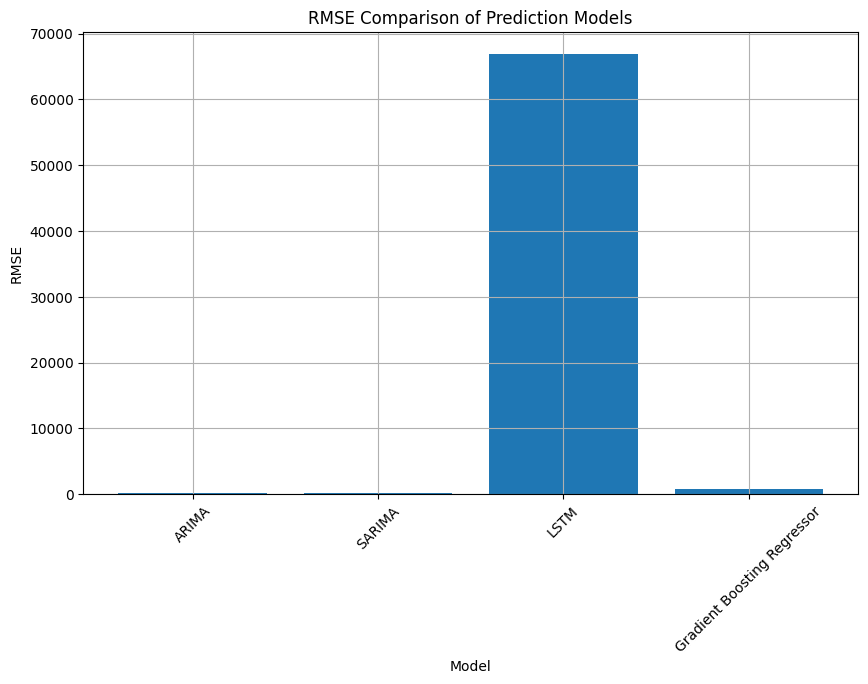

In [145]:
models = ['ARIMA', 'SARIMA', 'LSTM', 'Gradient Boosting Regressor']
rmse_values = [arima_rmse, sarimax_rmse, lstm_rmse, gbr_rmse]

# Plot the bar graph
plt.figure(figsize=(10, 6))
plt.bar(models, rmse_values)
plt.title('RMSE Comparison of Prediction Models')
plt.xlabel('Model')
plt.ylabel('RMSE')
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

In [162]:
## We are Selecting ARIMA and SARIMAX model for forecasting

# Load Save model for prediction

In [163]:
loaded_model = pickle.load(open('sarimax_model.pkl', 'rb'))

sarimaxForecast = loaded_model.forecast(forecastIndex)
sarimaxForecast = sarimaxForecast.reset_index()
sarimaxForecast
sarimaxForecastValue = sarimaxForecast['predicted_mean'][len(sarimaxForecast)-1]
print('forecast Value for', forecastTime, 'is', sarimaxForecastValue)

forecast Value for 2024-05-02 05:00:00 is 62991.30482264146
